In [2]:
import warnings
warnings.filterwarnings('ignore')

import os
from datetime import datetime, timedelta
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import sklearn.preprocessing
from sklearn.metrics import r2_score
import keras.optimizers

from keras.layers import Dense,Dropout,SimpleRNN,LSTM
from keras.models import Sequential
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import GridSearchCV
from statsmodels.tsa.stattools import adfuller

import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['font.family'] = 'Malgun Gothic'

In [3]:
#!pip install plotly

In [4]:
# Import basic modules
import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt
import sklearn

import seaborn as sns
from matplotlib import rcParams

# Import regression and error metrics modules
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

# Import plotly modules to view time series in a more interactive way
import plotly.graph_objects as go
import pandas as pd

# Standard scaler for preprocessing
from sklearn.preprocessing import StandardScaler

# Importing time series split for cross validation 
from sklearn.model_selection import TimeSeriesSplit

plt.style.use('bmh')

# special IPython command to prepare the notebook for matplotlib and other libraries
%matplotlib inline 

#sns.set_style("whitegrid")
#sns.set_context("poster")

In [5]:
# preprocessed data load
train = pd.read_csv('./data/train.csv', index_col = 0)
test = pd.read_csv('./data/test.csv', index_col = 0)

# 1. Defining Basic Functions

---

In [6]:
def plot_timeseries(ts, title = 'og', opacity = 1):
    """
    Plot plotly time series of any given timeseries ts
    """
    fig = go.Figure()

    fig.add_trace(go.Scatter(x = ts.index, y = ts.values, name = "observed",
                         line_color = 'lightslategrey', opacity = opacity))

    fig.update_layout(title_text = title,
                  xaxis_rangeslider_visible = True)
    fig.show()

In [7]:
def plot_ts_pred(og_ts, pred_ts, model_name=None, og_ts_opacity = 0.5, pred_ts_opacity = 0.5):
    """
    Plot plotly time series of the original (og_ts) and predicted (pred_ts) time series values to check how our model performs.
    model_name: name of the model used for predictions
    og_ts_opacity: opacity of the original time series
    pred_ts_opacity: opacity of the predicted time series
    """
    
    fig = go.Figure()

    fig.add_trace(go.Scatter(x = og_ts.index, y = np.array(og_ts.values), name = "Observed",
                         line_color = 'deepskyblue', opacity = og_ts_opacity))

    try:
        fig.add_trace(go.Scatter(x = pred_ts.index, y = pred_ts, name = model_name,
                         line_color = 'lightslategrey', opacity = pred_ts_opacity))
    except: #if predicted values are a numpy array they won't have an index
        fig.add_trace(go.Scatter(x = og_ts.index, y = pred_ts, name = model_name,
                         line_color = 'lightslategrey', opacity = pred_ts_opacity))


    #fig.add_trace(go)
    fig.update_layout(title_text = 'Observed test set vs predicted energy MWH values using {}'.format(model_name),
                  xaxis_rangeslider_visible = True)
    fig.show()

In [8]:
def train_test(data, test_size = 0.15, scale = False, cols_to_transform=None, include_test_scale=False):
    """
    
        Perform train-test split with respect to time series structure
        
        - df: dataframe with variables X_n to train on and the dependent output y which is the column 'SDGE' in this notebook
        - test_size: size of test set
        - scale: if True, then the columns in the -'cols_to_transform'- list will be scaled using StandardScaler
        - include_test_scale: If True, the StandardScaler fits the data on the training as well as the test set; if False, then
          the StandardScaler fits only on the training set.
        
    """
    df = data.copy()
    # get the index after which test set starts
    test_index = int(len(df)*(1-test_size))
    
    # StandardScaler fit on the entire dataset
    if scale and include_test_scale:
        scaler = StandardScaler()
        df[cols_to_transform] = scaler.fit_transform(df[cols_to_transform])
        
    X_train = df.drop('공급량', axis = 1).iloc[:test_index]
    y_train = df['공급량'].iloc[:test_index]
    X_test = df.drop('공급량', axis = 1).iloc[test_index:]
    y_test = df['공급량'].iloc[test_index:]
    
    # StandardScaler fit only on the training set
    if scale and not include_test_scale:
        scaler = StandardScaler()
        X_train[cols_to_transform] = scaler.fit_transform(X_train[cols_to_transform])
        X_test[cols_to_transform] = scaler.transform(X_test[cols_to_transform])
    
    return X_train, X_test, y_train, y_test

In [11]:
# creating function for plotting predicted vs actual energy values
def plot_predvstrue_reg(pred, truth, model_name=None):
    """
    Plots the observed energy consumption against the predicted energy consumption
    """
    fig, ax = plt.subplots(1,1, figsize=(8,8))
    ax.scatter(truth, pred) 
    _ = plt.xlabel("Observed supply")
    _ = plt.ylabel("Predicted supply")
    _ = plt.title("Observed vs Predicted supply using model {}".format(model_name))
    _ = plt.xlim(1000, 3000)
    _ = plt.ylim(1000, 3000)
    #plotting 45 deg line to see how the prediction differs from the observed values
    x = np.linspace(*ax.get_xlim())
    _ = ax.plot(x, x)

In [12]:
def error_metrics(y_pred, y_truth, model_name = None, test = True):
    """
    Printing error metrics like RMSE (root mean square error), R2 score, 
    MAE (mean absolute error), MAPE (mean absolute % error). 
    
    y_pred: predicted values of y using the model model_name
    y_truth: observed values of y
    model_name: name of the model used for predictions
    test: if validating on test set, True; otherwise False for training set validation
    
    The function will print the RMSE, R2, MAE and MAPE error metrics for the model_name and also store the results along with 
    model_name in the dictionary dict_error so that we can compare all the models at the end.
    """
    if isinstance(y_pred, np.ndarray):
        y_pred = y_pred
    else:
        y_pred = y_pred.to_numpy()
        
    if isinstance(y_truth, np.ndarray):
        y_truth = y_truth
    else:
        y_truth = y_truth.to_numpy()
        
    print('\nError metrics for model {}'.format(model_name))
    
    RMSE = np.sqrt(mean_squared_error(y_truth, y_pred))
    print("RMSE or Root mean squared error: %.2f" % RMSE)
    
    # Explained variance score: 1 is perfect prediction

    R2 = r2_score(y_truth, y_pred)
    print('Variance score: %.2f' % R2 )

    MAE = mean_absolute_error(y_truth, y_pred)
    print('Mean Absolute Error: %.2f' % MAE)

    MAPE = (np.mean(np.abs((y_truth - y_pred) / y_truth)) * 100)
    print('Mean Absolute Percentage Error: %.2f %%' % MAPE)
    
    # Appending the error values along with the model_name to the dict
    if test:
        train_test = 'test'
    else:
        train_test = 'train'
    
    #df = pd.DataFrame({'model': model_name, 'RMSE':RMSE, 'R2':R2, 'MAE':MAE, 'MAPE':MAPE}, index=[0])
    name_error = ['model', 'train_test', 'RMSE', 'R2', 'MAE', 'MAPE']
    value_error = [model_name, train_test, RMSE, R2, MAE, MAPE]
    list_error = list(zip(name_error, value_error))
    
    for error in list_error:
        if error[0] in dict_error:
            # append the new number to the existing array at this slot
            dict_error[error[0]].append(error[1])
        else:
            # create a new array in this slot
            dict_error[error[0]] = [error[1]]
    #return(dict_error)

# 2. Linear Reg to filter important variable

## 2.1 Preprocessing

In [13]:
# Index 자료형 datetime 
train.index = pd.DatetimeIndex(train.index)
train.index

DatetimeIndex(['2013-01-01 00:00:00', '2013-01-01 01:00:00',
               '2013-01-01 02:00:00', '2013-01-01 03:00:00',
               '2013-01-01 04:00:00', '2013-01-01 05:00:00',
               '2013-01-01 06:00:00', '2013-01-01 07:00:00',
               '2013-01-01 08:00:00', '2013-01-01 09:00:00',
               ...
               '2018-12-31 14:00:00', '2018-12-31 15:00:00',
               '2018-12-31 16:00:00', '2018-12-31 17:00:00',
               '2018-12-31 18:00:00', '2018-12-31 19:00:00',
               '2018-12-31 20:00:00', '2018-12-31 21:00:00',
               '2018-12-31 22:00:00', '2018-12-31 23:00:00'],
              dtype='datetime64[ns]', name='연월일시', length=368088, freq=None)

In [14]:
train.index.year

Int64Index([2013, 2013, 2013, 2013, 2013, 2013, 2013, 2013, 2013, 2013,
            ...
            2018, 2018, 2018, 2018, 2018, 2018, 2018, 2018, 2018, 2018],
           dtype='int64', name='연월일시', length=368088)

In [15]:
# column 생성
train['year'] = train.index.year
train['month'] = train.index.month
train['day'] = train.index.day
train['hour'] = train.index.hour
train['weekday'] = train.index.weekday
train['quarter'] = train.index.quarter

In [16]:
# creating categorical columns for linear regression 
cat_cols = ['year', 'month', 'day', 'hour', 'weekday', 'quarter', '구분']

for col in cat_cols:
    train[col] = train[col].astype('category')

# drop overlapping column 
train = train.drop(['연월일', '시간'], axis = 1)

train.info()
train.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 368088 entries, 2013-01-01 00:00:00 to 2018-12-31 23:00:00
Data columns (total 8 columns):
 #   Column   Non-Null Count   Dtype   
---  ------   --------------   -----   
 0   구분       368088 non-null  category
 1   공급량      368088 non-null  float64 
 2   year     368088 non-null  category
 3   month    368088 non-null  category
 4   day      368088 non-null  category
 5   hour     368088 non-null  category
 6   weekday  368088 non-null  category
 7   quarter  368088 non-null  category
dtypes: category(7), float64(1)
memory usage: 8.1 MB


,구분,공급량,year,month,day,hour,weekday,quarter
연월일시,,,,,,,,
2013-01-01 00:00:00,A,2497.129,2013,1,1,0,1,1
2013-01-01 01:00:00,A,2363.265,2013,1,1,1,1,1
2013-01-01 02:00:00,A,2258.505,2013,1,1,2,1,1
2013-01-01 03:00:00,A,2243.969,2013,1,1,3,1,1
2013-01-01 04:00:00,A,2344.105,2013,1,1,4,1,1


In [17]:
# preparing dummy columns for use in sklearn's linear regression
train_lin = pd.get_dummies(train, drop_first = True)

In [18]:
train_lin

,공급량,구분_B,구분_C,구분_D,구분_E,구분_G,구분_H,year_2014,year_2015,year_2016,...,hour_23,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,quarter_2,quarter_3,quarter_4
연월일시,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,2497.129,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 01:00:00,2363.265,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 02:00:00,2258.505,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 03:00:00,2243.969,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 04:00:00,2344.105,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31 19:00:00,681.033,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2018-12-31 20:00:00,669.961,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2018-12-31 21:00:00,657.941,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [19]:
train_lin.columns

Index(['공급량', '구분_B', '구분_C', '구분_D', '구분_E', '구분_G', '구분_H', 'year_2014',
       'year_2015', 'year_2016', 'year_2017', 'year_2018', 'month_2',
       'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',
       'month_9', 'month_10', 'month_11', 'month_12', 'day_2', 'day_3',
       'day_4', 'day_5', 'day_6', 'day_7', 'day_8', 'day_9', 'day_10',
       'day_11', 'day_12', 'day_13', 'day_14', 'day_15', 'day_16', 'day_17',
       'day_18', 'day_19', 'day_20', 'day_21', 'day_22', 'day_23', 'day_24',
       'day_25', 'day_26', 'day_27', 'day_28', 'day_29', 'day_30', 'day_31',
       'hour_1', 'hour_2', 'hour_3', 'hour_4', 'hour_5', 'hour_6', 'hour_7',
       'hour_8', 'hour_9', 'hour_10', 'hour_11', 'hour_12', 'hour_13',
       'hour_14', 'hour_15', 'hour_16', 'hour_17', 'hour_18', 'hour_19',
       'hour_20', 'hour_21', 'hour_22', 'hour_23', 'weekday_1', 'weekday_2',
       'weekday_3', 'weekday_4', 'weekday_5', 'weekday_6', 'quarter_2',
       'quarter_3', 'quarter_4'],
    

## 2.2 Statsmodel Fitting

In [20]:
# Checking linear regression fit using statsmodels Linear regression

m = ols('공급량 ~  C(year) + C(month) + C(hour) + C(quarter) + C(구분)', train).fit()
print(m.summary())

                            OLS Regression Results                            
Dep. Variable:                    공급량   R-squared:                       0.798
Model:                            OLS   Adj. R-squared:                  0.798
Method:                 Least Squares   F-statistic:                 3.024e+04
Date:                Mon, 01 Nov 2021   Prob (F-statistic):               0.00
Time:                        15:16:20   Log-Likelihood:            -2.7430e+06
No. Observations:              368088   AIC:                         5.486e+06
Df Residuals:                  368039   BIC:                         5.487e+06
Df Model:                          48                                         
Covariance Type:            nonrobust                                         
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept        1977.9600      4.770    4

#### Obserbed vs Prediced using LR 

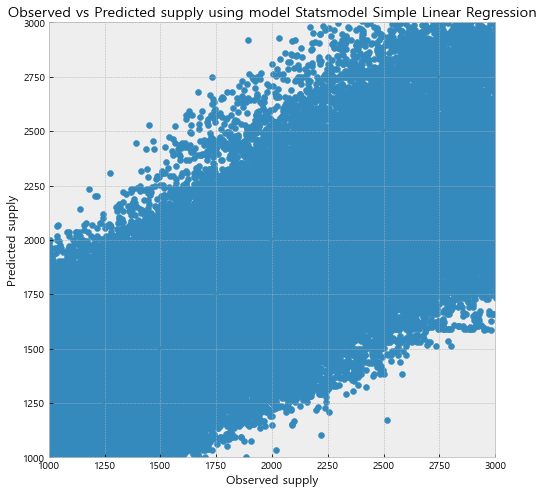

In [21]:
plot_predvstrue_reg(m.fittedvalues, train.공급량, model_name = 'Statsmodel Simple Linear Regression')

- R2, and adj-R2 0.798
- important variables: hour, year, 
- predict well when supply amount is below around 2500, 

## 2.3 Sklearn LR fitting

In [22]:
train_lin.columns

Index(['공급량', '구분_B', '구분_C', '구분_D', '구분_E', '구분_G', '구분_H', 'year_2014',
       'year_2015', 'year_2016', 'year_2017', 'year_2018', 'month_2',
       'month_3', 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',
       'month_9', 'month_10', 'month_11', 'month_12', 'day_2', 'day_3',
       'day_4', 'day_5', 'day_6', 'day_7', 'day_8', 'day_9', 'day_10',
       'day_11', 'day_12', 'day_13', 'day_14', 'day_15', 'day_16', 'day_17',
       'day_18', 'day_19', 'day_20', 'day_21', 'day_22', 'day_23', 'day_24',
       'day_25', 'day_26', 'day_27', 'day_28', 'day_29', 'day_30', 'day_31',
       'hour_1', 'hour_2', 'hour_3', 'hour_4', 'hour_5', 'hour_6', 'hour_7',
       'hour_8', 'hour_9', 'hour_10', 'hour_11', 'hour_12', 'hour_13',
       'hour_14', 'hour_15', 'hour_16', 'hour_17', 'hour_18', 'hour_19',
       'hour_20', 'hour_21', 'hour_22', 'hour_23', 'weekday_1', 'weekday_2',
       'weekday_3', 'weekday_4', 'weekday_5', 'weekday_6', 'quarter_2',
       'quarter_3', 'quarter_4'],
    

In [23]:
"""train_lin.drop([ 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',
       'month_9', 'month_10', 'month_11', 'month_12','quarter_2',
       'quarter_3', 'quarter_4'], axis = 1, inplace = True)"""

"train_lin.drop([ 'month_4', 'month_5', 'month_6', 'month_7', 'month_8',\n       'month_9', 'month_10', 'month_11', 'month_12','quarter_2',\n       'quarter_3', 'quarter_4'], axis = 1, inplace = True)"

In [24]:
train_lin

,공급량,구분_B,구분_C,구분_D,구분_E,구분_G,구분_H,year_2014,year_2015,year_2016,...,hour_23,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6,quarter_2,quarter_3,quarter_4
연월일시,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,2497.129,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 01:00:00,2363.265,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 02:00:00,2258.505,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 03:00:00,2243.969,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
2013-01-01 04:00:00,2344.105,0,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31 19:00:00,681.033,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2018-12-31 20:00:00,669.961,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1
2018-12-31 21:00:00,657.941,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [25]:
# Creating the train and test data
# A test_size og 0.15 gives us a training set of 4 years and 3 months and a test set of 9 months (the test set includes 
#...winter and summer seasons.

#cols_to_transform = ['HourlyDryBulbTemperature', 'cum_AC_kW'] # other columns are binary values
X_train, X_test, y_train, y_test = train_test(train_lin, test_size = 0.15, scale = False)

# This creates a LinearRegression object
lm = LinearRegression()
lm

LinearRegression()

In [26]:
# fitting the linear regression model
lm.fit(X_train, y_train)

LinearRegression()

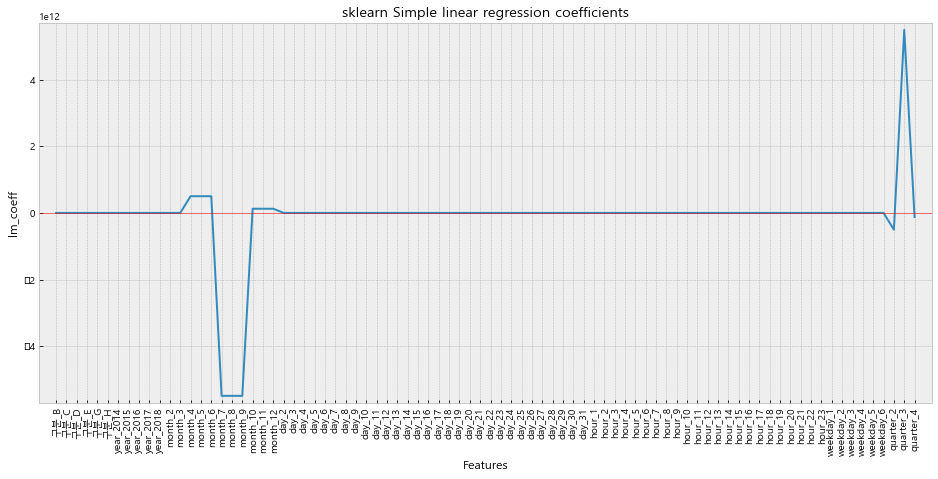

In [27]:
# Plotting the coefficients to check the importance of each coefficient 

# Plot the coefficients
_ = plt.figure(figsize = (16, 7))
_ = plt.plot(range(len(X_train.columns)), lm.coef_)
_ = plt.xticks(range(len(X_train.columns)), X_train.columns.values, rotation = 90)
_ = plt.margins(0.02)
_ = plt.axhline(0, linewidth = 0.5, color = 'r')
_ = plt.title('sklearn Simple linear regression coefficients')
_ = plt.ylabel('lm_coeff')
_ = plt.xlabel('Features')

- positive relation: 구분EG, month2, hour8, hour 19, 
- negative relation: 구분CH, hour2, 
- the most significant variable: 구분, month, hour 

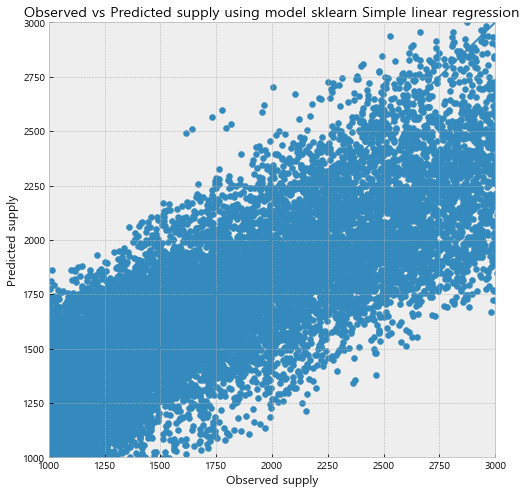

In [28]:
# Plotting lm.predict(X) vs observed energy consumption

plot_predvstrue_reg(lm.predict(X_test), y_test, model_name = 'sklearn Simple linear regression')

In [29]:
error_metrics(lm.predict(X_train), y_train, model_name = 'Simple linear regression with scaling', test = False)


Error metrics for model Simple linear regression with scaling
RMSE or Root mean squared error: 403.52
Variance score: 0.80
Mean Absolute Error: 305.53
Mean Absolute Percentage Error: 242.39 %


NameError: name 'dict_error' is not defined

In [30]:
# on test set
error_metrics(lm.predict(X_test), y_test, model_name = 'Simple linear regression with scaling', test = True)


Error metrics for model Simple linear regression with scaling
RMSE or Root mean squared error: 470.32
Variance score: 0.79
Mean Absolute Error: 332.01
Mean Absolute Percentage Error: 255.54 %


NameError: name 'dict_error' is not defined

In [31]:
# Plotting the predicted values with the original time series (test set)
plot_ts_pred(y_test, lm.predict(X_test), model_name='Simple linear regression with scaling', 
             og_ts_opacity = 0.5, pred_ts_opacity = 0.5)


## 2.4 Baseline model

In [112]:
# Calculating the errors for persistent forecast (where we simply repeat the values from last year)
#y_test.index.year
_ = error_metrics(train_lin.loc[X_test.index.shift(-8760, freq='H'), '공급량'], 
                  y_test, model_name='Baseline Persistent forecast, repeat last year', test=True)


Error metrics for model Baseline Persistent forecast, repeat last year


ValueError: Found input variables with inconsistent numbers of samples: [55214, 386498]

In [111]:
plot_ts_pred(y_test, train_llin.loc[X_test.index.shift(-8760, freq='H'), '공급량'].to_numpy(),
             model_name='Baseline Persistent forecast, repeat last year')

# 3. Adding lagged vlaues as X 

#### Filtering 구분 = D

In [139]:
train_D = train.query("구분 == 'D'")
#train_D

In [140]:
# Adding max 24 lags; lag1 is the value of the energy consumption in the previous hour, lag2 is the value of energy consumption..
#..2 hours before the current value and so on.

# Creating the lag variables
for i in range(24):
    train_D['lag'+str(i+1)] = train_D['공급량'].shift(i+1)

In [141]:
train_D.drop(['구분'], axis = 1, inplace =True)
train_D

,공급량,year,month,day,hour,weekday,quarter,lag1,lag2,lag3,...,lag15,lag16,lag17,lag18,lag19,lag20,lag21,lag22,lag23,lag24
연월일시,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,1434.516,2013,1,1,0,1,1,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 01:00:00,1345.636,2013,1,1,1,1,1,1434.516,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 02:00:00,1270.756,2013,1,1,2,1,1,1345.636,1434.516,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 03:00:00,1322.036,2013,1,1,3,1,1,1270.756,1345.636,1434.516,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2013-01-01 04:00:00,1421.956,2013,1,1,4,1,1,1322.036,1270.756,1345.636,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-31 19:00:00,1835.411,2018,12,31,19,0,4,1798.397,1630.876,1456.313,...,1405.614,1306.768,1241.804,1287.426,1408.316,1508.466,1606.503,1674.036,1742.893,1821.105
2018-12-31 20:00:00,1767.964,2018,12,31,20,0,4,1835.411,1798.397,1630.876,...,1472.189,1405.614,1306.768,1241.804,1287.426,1408.316,1508.466,1606.503,1674.036,1742.893
2018-12-31 21:00:00,1720.595,2018,12,31,21,0,4,1767.964,1835.411,1798.397,...,1638.283,1472.189,1405.614,1306.768,1241.804,1287.426,1408.316,1508.466,1606.503,1674.036


In [142]:
# Since the first 24 values won't have any 24th lag, they will be NaN. So dropping the NaNs
train_D_lag = train_D.dropna()

In [143]:
train_D_lag.head()

,공급량,year,month,day,hour,weekday,quarter,lag1,lag2,lag3,...,lag15,lag16,lag17,lag18,lag19,lag20,lag21,lag22,lag23,lag24
연월일시,,,,,,,,,,,,,,,,,,,,,
2013-01-02 00:00:00,1291.316,2013,1,2,0,2,1,1413.716,1511.156,1645.396,...,1741.316,1613.236,1461.556,1352.996,1360.036,1421.956,1322.036,1270.756,1345.636,1434.516
2013-01-02 01:00:00,1176.516,2013,1,2,1,2,1,1291.316,1413.716,1511.156,...,1816.916,1741.316,1613.236,1461.556,1352.996,1360.036,1421.956,1322.036,1270.756,1345.636
2013-01-02 02:00:00,1144.196,2013,1,2,2,2,1,1176.516,1291.316,1413.716,...,1654.276,1816.916,1741.316,1613.236,1461.556,1352.996,1360.036,1421.956,1322.036,1270.756
2013-01-02 03:00:00,1282.356,2013,1,2,3,2,1,1144.196,1176.516,1291.316,...,1432.116,1654.276,1816.916,1741.316,1613.236,1461.556,1352.996,1360.036,1421.956,1322.036
2013-01-02 04:00:00,1460.996,2013,1,2,4,2,1,1282.356,1144.196,1176.516,...,1287.716,1432.116,1654.276,1816.916,1741.316,1613.236,1461.556,1352.996,1360.036,1421.956


#### Elastic Net

In [144]:
from sklearn.linear_model import ElasticNet


In [145]:
# Fitting Elastic Net Regression model using the lag variables as the additional inputs ...
#...(extending the reduced space model)

# Not tuning the elastic net this time because we will see that there hardly any scope for improvement in the excellent results
#..we get

cols_to_transform = []
# Adding the energy consumption lags to the columns to transform 
list_lags = ['lag'+str(i+1) for i in range(24)]
cols_to_transform.extend(list_lags)

X_train_lag, X_test_lag, y_train_lag, y_test_lag = train_test(train_D_lag, test_size = 0.15, scale = True, cols_to_transform= cols_to_transform)

In [146]:
elastic_net_lag = ElasticNet(l1_ratio = 1, alpha=0.2)
elastic_net_lag.fit(X_train_lag, y_train_lag)

ElasticNet(alpha=0.2, l1_ratio=1)

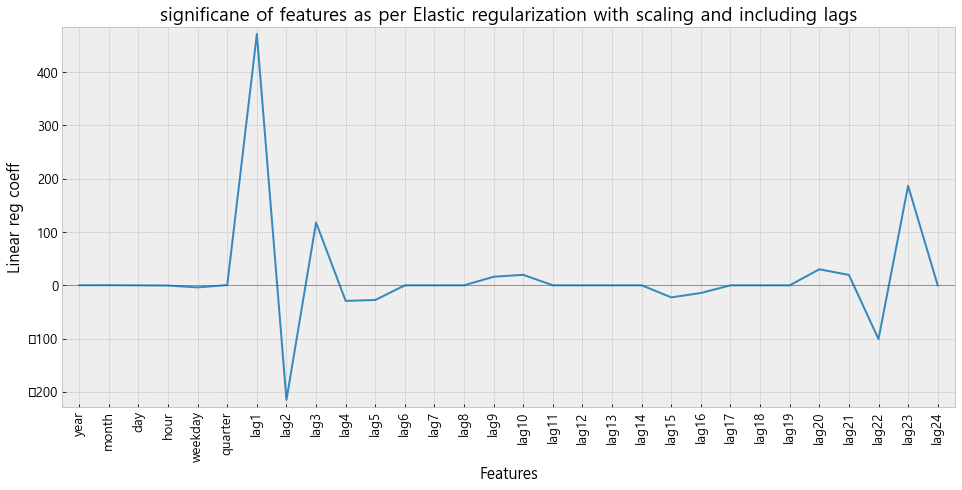

In [147]:
# Plot the coefficients
_ = plt.figure(figsize = (16, 7))
_ = plt.plot(range(len(X_train_lag.columns)), elastic_net_lag.coef_)
_ = plt.xticks(range(len(X_train_lag.columns)), X_train_lag.columns.values, rotation = 90)
_ = plt.margins(0.02)
_ = plt.axhline(0, linewidth = 0.5, color = 'r')
_ = plt.title('significane of features as per Elastic regularization with scaling and including lags')
_ = plt.ylabel('Linear reg coeff')
_ = plt.xlabel('Features')

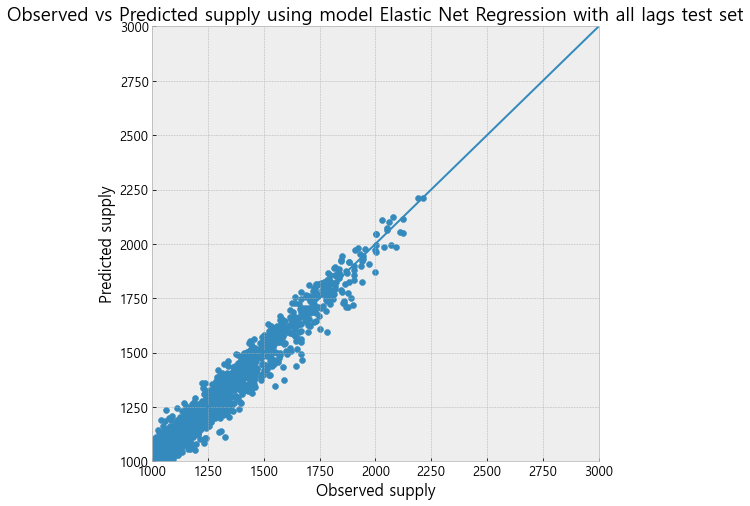

In [151]:
plot_predvstrue_reg(elastic_net_lag.predict(X_test_lag), y_test_lag, 
                    model_name = 'Elastic Net Regression with all lags test set')

In [156]:
test.index = pd.DatetimeIndex(test.index)

In [160]:
test['year'] = test.index.year
test['month'] = test.index.month
test['day'] = test.index.day
test['hour'] = test.index.hour
test['weekday'] = test.index.weekday
test['quarter'] = test.index.quarter

In [181]:
X_train_lag.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 44676 entries, 2013-01-02 00:00:00 to 2018-02-06 11:00:00
Data columns (total 30 columns):
 #   Column   Non-Null Count  Dtype   
---  ------   --------------  -----   
 0   year     44676 non-null  category
 1   month    44676 non-null  category
 2   day      44676 non-null  category
 3   hour     44676 non-null  category
 4   weekday  44676 non-null  category
 5   quarter  44676 non-null  category
 6   lag1     44676 non-null  float64 
 7   lag2     44676 non-null  float64 
 8   lag3     44676 non-null  float64 
 9   lag4     44676 non-null  float64 
 10  lag5     44676 non-null  float64 
 11  lag6     44676 non-null  float64 
 12  lag7     44676 non-null  float64 
 13  lag8     44676 non-null  float64 
 14  lag9     44676 non-null  float64 
 15  lag10    44676 non-null  float64 
 16  lag11    44676 non-null  float64 
 17  lag12    44676 non-null  float64 
 18  lag13    44676 non-null  float64 
 19  lag14    44676 non-null  float64

In [161]:
# creating categorical columns for linear regression 
cat_cols = ['year', 'month', 'day', 'hour', 'weekday', 'quarter', '구분']

for col in cat_cols:
    test[col] = test[col].astype('category')

train.info()
train.head()

# preparing dummy columns for use in sklearn's linear regression
test_elastic = pd.get_dummies(test, drop_first = True)

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 368088 entries, 2013-01-01 00:00:00 to 2018-12-31 23:00:00
Data columns (total 8 columns):
 #   Column   Non-Null Count   Dtype   
---  ------   --------------   -----   
 0   구분       368088 non-null  category
 1   공급량      368088 non-null  float64 
 2   year     368088 non-null  category
 3   month    368088 non-null  category
 4   day      368088 non-null  category
 5   hour     368088 non-null  category
 6   weekday  368088 non-null  category
 7   quarter  368088 non-null  category
dtypes: category(7), float64(1)
memory usage: 16.1 MB


In [172]:
cols_to_append= []
for item in X_test.columns:
    if item not in test_elastic.columns:
        cols_to_append.append(item)

In [174]:
test_elastic[cols_to_append] = 0

In [176]:
test_elastic_X = test_elastic.drop('공급량', axis = 1)

In [177]:
test_elastic_X

,구분_B,구분_C,구분_D,구분_E,구분_G,구분_H,month_2,month_3,day_2,day_3,...,month_6,month_7,month_8,month_9,month_10,month_11,month_12,quarter_2,quarter_3,quarter_4
일자,,,,,,,,,,,,,,,,,,,,,
2019-01-01 00:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-01-01 01:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-01-01 02:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-01-01 03:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-01-01 04:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-03-31 19:00:00,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-03-31 20:00:00,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2019-03-31 21:00:00,0,0,0,0,0,1,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [179]:
y_hats = []
for idx in range(15120)
y_hat = elastic_net_lag.predict(test_elastic_X.values)

ValueError: matmul: Input operand 1 has a mismatch in its core dimension 0, with gufunc signature (n?,k),(k,m?)->(n?,m?) (size 30 is different from 84)

# 4. Time Series Modeling

In [34]:
train_D = train.query("구분 == 'D'")['공급량']
#train_D

#### Overview whole data

In [35]:
# Plotting our original time series
plot_timeseries(train_D, title = 'Original data set')

#### Decompose to identify its multiple components

In [36]:
from statsmodels.graphics import tsaplots
import statsmodels.api as sm

In [37]:
# plot size global option
plt.rc("figure", figsize=(16, 12))
plt.rc("font", size=13)

In [38]:
24*52*7

8736

In [39]:
# Run seasonal decompose
decomp = sm.tsa.seasonal_decompose(train_D, period = 24*7*52)
# capturing the yearly seasonal component, winter season the highest, summer season the lowest 

print(decomp.seasonal.head()) # checking the seasonal component
#_ = decomp.plot()

연월일시
2013-01-01 00:00:00    454.531114
2013-01-01 01:00:00    311.024368
2013-01-01 02:00:00    236.630345
2013-01-01 03:00:00    322.046288
2013-01-01 04:00:00    421.884154
Name: seasonal, dtype: float64


In [40]:
train_D['seasonal'] = decomp.seasonal

In [41]:
# Plotting the seasonal component only
plot_timeseries(train_D['seasonal'], title = 'Seasonal component')

In [42]:
train_D['trend'] = decomp.trend

<AxesSubplot:xlabel='연월일시'>

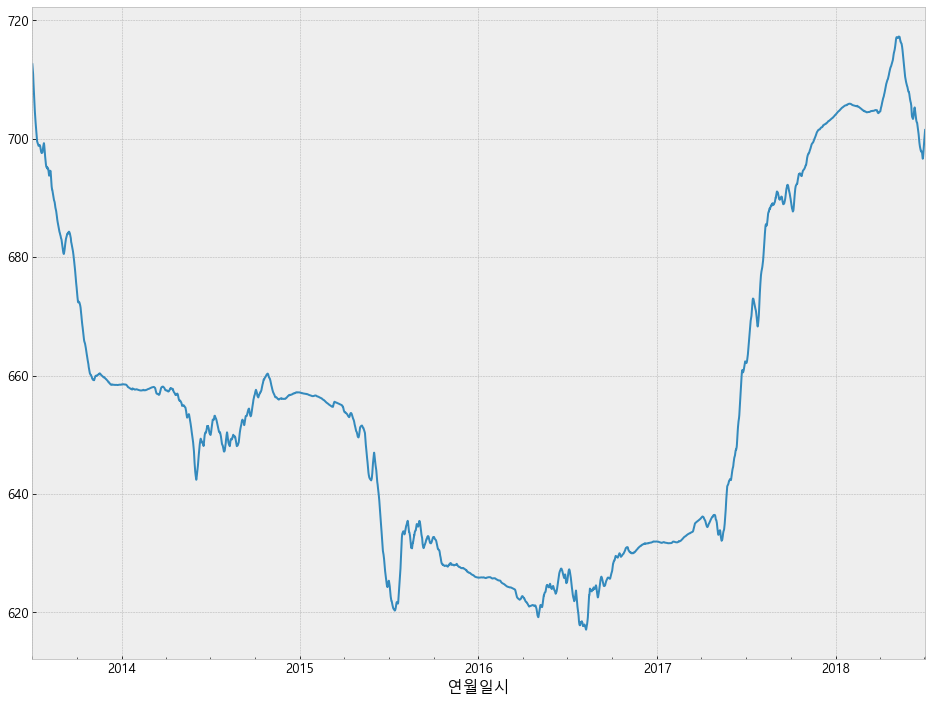

In [43]:
# Plotting the trend (the starting 6 months and the end 6 months of data is NaN because we had set the periodicity as 24*365,
#... so the trend data will have 8760 less values)
train_D['trend'].dropna().plot()

In [44]:
train_D['resid'] = decomp.resid

<AxesSubplot:xlabel='연월일시'>

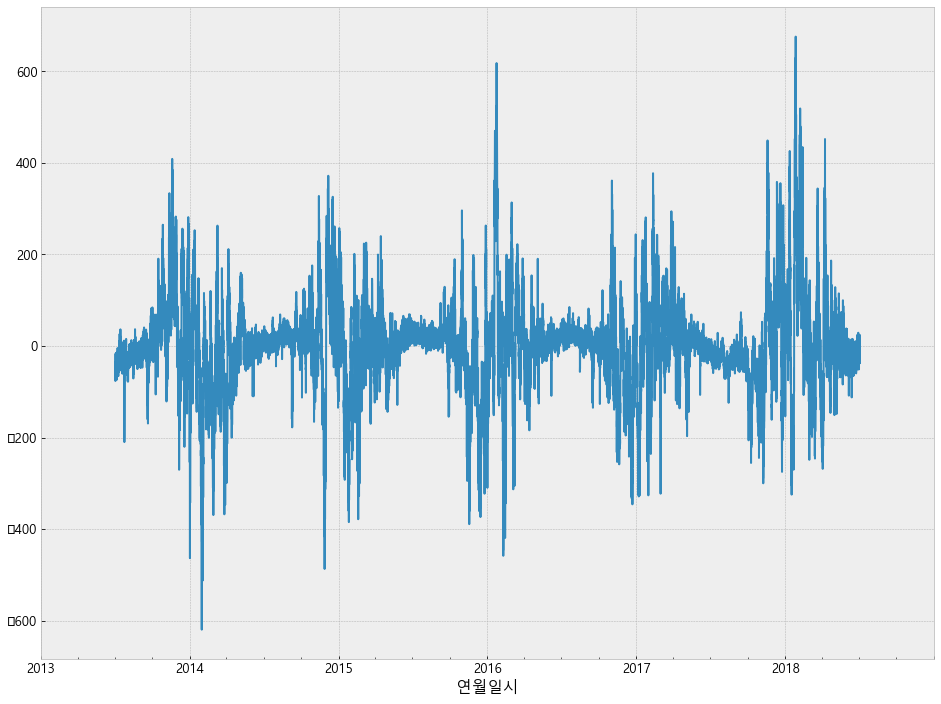

In [45]:
train_D['resid'].plot()